In [149]:
import os, sys, time

import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable, Function

import torchvision.models as models
import torchvision.datasets as datasets
import torchvision.transforms as transforms

import pylab
import matplotlib.pyplot as plt

from scipy.misc import imread, imresize
from scipy.stats import pearsonr

from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist

from invert import invert

from indexdata import load_image_to_label
from indexdataset import load_image_dataset_label_index
from voclabels import voc_labels

import loadseg
import expdir
import intersect
import upsample
from labelprobe import cached_memmap

import sys
from viewprobe import NetworkProbe

import matplotlib
from matplotlib.ticker import FuncFormatter

from linearprobe_pytorch import CustomLayer

%matplotlib inline

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
def to_percent(y, position):
    # Ignore the passed in position. This has the effect of scaling the default
    # tick locations.
    s = str(int(100 * y))

    # The percent symbol needs escaping in latex
    if matplotlib.rcParams['text.usetex'] is True:
        return s + r'$\%$'
    else:
        return s + '%'

In [3]:
import matplotlib.pylab as pylab
params = {'axes.labelsize': 16,
         'axes.titlesize':16,
         'xtick.labelsize':14,
         'ytick.labelsize':14,
         'legend.fontsize':14}
pylab.rcParams.update(params)

In [4]:
gpu = 1

cuda = True if gpu is not None else False
use_mult_gpu = isinstance(gpu, list)
if cuda:
    if use_mult_gpu:
        os.environ['CUDA_VISIBLE_DEVICES'] = str(gpu).strip('[').strip(']')
    else:
        os.environ['CUDA_VISIBLE_DEVICES'] = '%d' % gpu
print(torch.cuda.device_count(), use_mult_gpu, cuda)

(1L, False, True)


In [5]:
blob_names = {
    'features.1': 'relu1',
    'features.4': 'relu2',
    'features.7': 'relu3',
    'features.9': 'relu4',
    'features.11': 'relu5',
    'features': 'pool5'
}

In [6]:
directory='/home/ruthfong/NetDissect/probes/pytorch_alexnet_imagenet'
if not os.path.exists(directory):
    directory='/scratch/shared/slow/ruthfong/pytorch_alexnet_imagenet'
    assert(os.path.exists(directory))
blob='features.11'

In [7]:
ed = expdir.ExperimentDirectory(directory)

In [8]:
info = ed.load_info()
blob_info = ed.load_info(blob=blob)
shape = blob_info.shape
ds = loadseg.SegmentationData(info.dataset)
categories = np.array(ds.category_names())

In [9]:
K = shape[1]
L = ds.label_size()
N = ds.size()

label_names = np.array([ds.label[i]['name'] for i in range(L)])

In [10]:
blobs = ['features.1', 'features.4', 'features.7', 'features.9', 'features.11']

suffix=''

linear_ind_ious = {}
single_ind_ious = {}
linear_set_ious = {}
weights = {}

single_set_train_ious = {}
single_set_val_ious = {}

for blob in blobs:
    blob_info = ed.load_info(blob=blob)
    shape = blob_info.shape
    K = shape[1]
    linear_ind_ious[blob] = ed.open_mmap(blob=blob, part='linear_ind_ious', mode='r', dtype='float32', shape=(L,N))
    single_ind_ious[blob] = ed.open_mmap(blob=blob, part='single_ind_ious', mode='r', dtype='float32', suffix=suffix, shape=(L,N,K))
    linear_set_ious[blob] = ed.open_mmap(blob=blob, part='linear_set_val_ious', mode='r', dtype='float32', shape=(L,))
    single_set_train_ious[blob] = ed.open_mmap(blob=blob, part='single_set_train_ious', mode='r', dtype='float32', suffix=suffix, shape=(L,K))
    single_set_val_ious[blob] = ed.open_mmap(blob=blob, part='single_set_val_ious', mode='r', dtype='float32', suffix=suffix, shape=(L,K))
    weights[blob] = ed.open_mmap(blob=blob, part='linear_weights', mode='r', dtype='float32', shape=(L,K))
    
linear_ind_ious_val = {}
linear_set_ious_val = {}
linear_set_train_ious_val = {}
linear_set_val_ious_val = {}
weights_val = {}

suffix = '_validation'
for blob in ['features.9', 'features.11']:
    blob_info = ed.load_info(blob=blob)
    shape = blob_info.shape
    K = shape[1]
    linear_ind_ious_val[blob] = ed.open_mmap(blob=blob, part='linear_ind_ious%s' % suffix, mode='r', dtype='float32', shape=(L,N))
    linear_set_ious_val[blob] = ed.open_mmap(blob=blob, part='linear_set_ious%s' % suffix, mode='r', dtype='float32', shape=(L,))
    linear_set_train_ious_val[blob] = ed.open_mmap(blob=blob, part='linear_set_train_ious%s' % suffix, mode='r', dtype='float32', shape=(L,))
    linear_set_val_ious_val[blob] = ed.open_mmap(blob=blob, part='linear_set_val_ious%s' % suffix, mode='r', dtype='float32', shape=(L,))
    weights_val[blob] = ed.open_mmap(blob=blob, part='linear_weights%s' % suffix, mode='r', dtype='float32', shape=(L,K))

In [11]:
thresh = {}
quantile = 0.005
qcode = ('%f' % quantile).replace('0.','').rstrip('0')
blobdata = {}

for blob in blobs: 
    blob_info = ed.load_info(blob=blob)
    shape = blob_info.shape
    K = shape[1]
    
    quantdata = ed.open_mmap(blob=blob, part='quant-*', shape=(K, -1))
    threshold = quantdata[:, int(round(quantdata.shape[1] * quantile))]
    thresh[blob] = np.copy(threshold[:, np.newaxis, np.newaxis])
    blobdata[blob] = ed.open_mmap(blob=blob, mode='r', dtype='float32', shape=shape)

In [12]:
train_idx = np.array([ds.split(i) == 'train' for i in range(N)])
val_idx = np.array([ds.split(i) == 'val' for i in range(N)])
train_ind = np.array([True if ds.split(i) == 'train' else False for i in range(N)])
val_ind = np.array([True if ds.split(i) == 'val' else False for i in range(N)])

In [13]:
image_to_label = load_image_to_label(directory)
pc = ds.primary_categories_per_index()
pc[0] = -1

In [54]:
suffix = '_lr_1e-1_sgd_quant_1_epochs_30_iter_15_num_filters_2'
#num_filters = [1, 2, 3, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 80, 100, 128]
#F = len(num_filters) + 1
F = 2
epochs = 30

In [55]:
 disc_weights = {}
disc_bias = {}
disc_results = {}

for blob in blobs:
    blob_info = ed.load_info(blob=blob)
    shape = blob_info.shape
    K = shape[1]
    disc_weights[blob] = ed.open_mmap(blob=blob, part='linear_weights_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F, K))
    disc_bias[blob] = ed.open_mmap(blob=blob, part='linear_bias_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F))
    disc_results[blob] = ed.open_mmap(blob=blob, part='linear_results_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F, 4, epochs))

In [56]:
suffix = '_lr_1e-1_sgd_quant_1_epochs_30_iter_15_num_filters'
num_filters = [1, 2, 3, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 80, 100, 128]
F = len(num_filters) + 1

disc_weights_all = {}
disc_bias_all = {}
disc_results_all = {}

for blob in blobs[2:]:
    blob_info = ed.load_info(blob=blob)
    shape = blob_info.shape
    K = shape[1]

    disc_weights_all[blob] = ed.open_mmap(blob=blob, part='linear_weights_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F, K))
    disc_bias_all[blob] = ed.open_mmap(blob=blob, part='linear_bias_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F))
    disc_results_all[blob] = ed.open_mmap(blob=blob, part='linear_results_disc%s' % suffix, mode='r', dtype='float32', shape=(L, F, 4, epochs))

In [64]:
top = {}

for blob in blobs:
    blob_info = ed.load_info(blob=blob)
    imgmax = ed.open_mmap(blob=blob, part='imgmax', mode='r', shape=blob_info.shape[:2])
    top[blob] = imgmax.argsort(axis=0).transpose()

In [204]:
blob = 'features.11'
num_filters = np.array([1, 2, 4, 8, 16, 32, 64, 128,160,192,224])
suffixes = ['_num_filters_%d' % n for n in num_filters]
suffixes.append('')

linear_set_ious_num_filters = np.zeros((L,len(suffixes)))
for i in range(len(suffixes)):
    linear_set_ious_num_filters[:,i] = ed.open_mmap(blob=blob, part='linear_set_val_ious%s' % suffixes[i], mode='r', 
                                               dtype='float32', shape=(L,))

In [168]:
blob = 'features.11'

#new_suffix = '_normalized'
new_suffix = '_quant_005'
linear_imgmax = ed.open_mmap(blob=blob, part='linear_imgmax%s' % new_suffix, mode='r', shape=(N,L))

linear_top = linear_imgmax.argsort(axis=0).transpose()
#linear_top_val = linear_disc_imgmax[val_ind,:].argsort(axis=0).transpose()

In [17]:
def get_single_acts(acts, thresh, filter_i, up_size=(224,224), thresh_first=True):
    upsample = nn.Upsample(size=up_size, mode='bilinear')
    if thresh_first:
        return upsample(Variable(torch.Tensor((acts > thresh).astype(float)))).data.cpu().numpy()[0,filter_i]
    else:
        return (upsample(Variable(torch.Tensor(acts))).data.cpu().numpy()[0] > thresh).astype(float)[filter_i]

In [96]:
def get_weighted_acts(acts, thresh, label_weights, label_bias=None,up_size=(224,224), act=True, 
                      positive=False, bias=False, thresh_first=True):
    layer = CustomLayer(len(label_weights), upsample=thresh_first, up_size=up_size, act=act, positive=positive, bias=bias)
    layer.weight.data[...] = torch.Tensor(label_weights)
    if bias:
        assert(label_bias is not None)
        layer.bias.data[...] = torch.Tensor(label_bias)
    if thresh_first:
        return layer(Variable(torch.Tensor((acts > thresh).astype(float)))).data.cpu().numpy()
    else:
        upsample = nn.Upsample(size=up_size, mode='bilinear')
        return layer((upsample(Variable(torch.Tensor(acts))) > Variable(torch.Tensor(thresh))).type(torch.FloatTensor)).data.cpu().numpy()

In [97]:
def show_examples_for_unit(blob, unit_i, examples_idx, up_size=(224,224), num_to_show=8, mask_alpha=0.2, thresh_first=False):
    f, ax = plt.subplots(1,num_to_show,figsize=(4*num_to_show,4))
    for i in range(num_to_show):
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        if i == 0:
            pass
            #ax[i].set_ylabel('unit %d' % unit_i)
        try:
            up = get_single_acts(np.expand_dims(blobdata[blob][examples_idx[i]], axis=0), thresh[blob], unit_i, up_size=up_size, thresh_first=thresh_first)
            ax[i].imshow((np.expand_dims((up > 0.5), axis=2) * (1-mask_alpha) + mask_alpha) * imread(ds.filename(examples_idx[i]))/255.)
            #ax[i].imshow(probe.activation_visualization(blob, unit_i, top[unit_i][i], normalize=True, use_fieldmap=False))
        except:
            break
    f.subplots_adjust(wspace=0.0,hspace=0.0)
    #plt.tight_layout()
    plt.show()

In [98]:
def show_examples_for_linear(blob, label_weights, examples_idx, up_size=(224,224), num_to_show=8, mask_alpha=0.2, 
                             thresh_first=False):
    f, ax = plt.subplots(1,num_to_show,figsize=(4*num_to_show,4))
    for i in range(num_to_show):
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        if i == 0:
            pass
            #ax[i].set_ylabel('unit %d' % unit_i)
        try:
            up = get_weighted_acts(np.expand_dims(blobdata[blob][examples_idx[i]], axis=0), thresh[blob], label_weights, label_bias=None,
                              up_size=up_size, act=True, positive=False, bias=False, thresh_first=thresh_first)
        except:
            break
        ax[i].imshow((np.expand_dims((up > 0.5), axis=2) * (1-mask_alpha) + mask_alpha) * imread(ds.filename(examples_idx[i]))/255.)

    f.subplots_adjust(wspace=0.0,hspace=0.0)
    plt.show()

In [70]:
def find_label(phrase, label_names=label_names):
    return np.array([i for i in range(len(label_names)) if phrase in label_names[i]])

In [71]:
def find_exact_label(phrase, label_names=label_names):
    for i in range(len(label_names)):
        if phrase == label_names[i]:
            return i
    else:
        return -1

## Quantifying the Filter-Concept Overlap

682


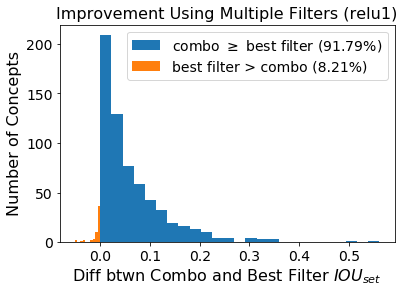

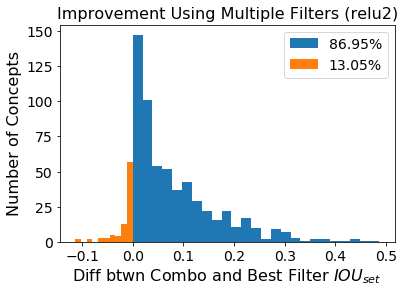

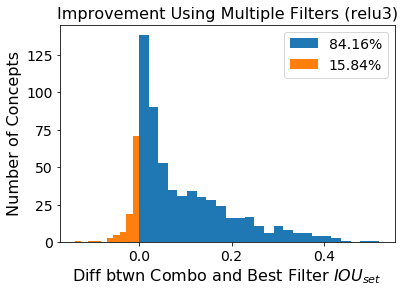

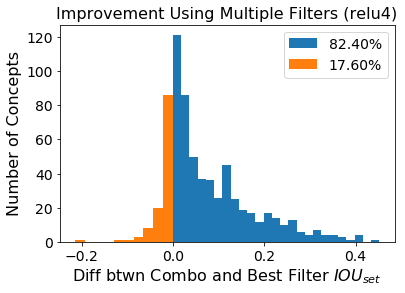

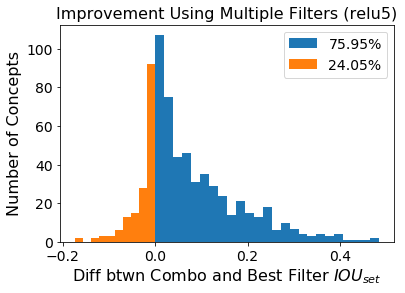

In [53]:
idx = np.array([i for i in range(len(pc)) if pc[i] < 4 and pc[i] >= 0])
print len(idx)

for blob in blobs:
    best_filters = np.argmax(single_set_train_ious[blob], axis=1)
    best_set_ious = np.array([single_set_val_ious[blob][idx[i]][best_filters[idx[i]]] for i in range(len(idx))])
    set_iou_diff = linear_set_ious[blob][idx] - best_set_ious

    f, ax = plt.subplots(1,1)
    if blob == blobs[0]:
        ax.hist(set_iou_diff[set_iou_diff >= 0], bins=25, label='combo $\geq$ best filter (%.2f%%)' % (100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))
        ax.hist(set_iou_diff[set_iou_diff < 0], bins=10, label='best filter > combo (%.2f%%)' % (100-100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))
    else:
        ax.hist(set_iou_diff[set_iou_diff >= 0], bins=25, label='%.2f%%' % (100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))
        ax.hist(set_iou_diff[set_iou_diff < 0], bins=10, label='%.2f%%' % (100-100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))

    ax.legend()
    ax.set_xlabel('Diff btwn Combo and Best Filter $IOU_{set}$')
    ax.set_ylabel('Number of Concepts')
    ax.set_title('Improvement Using Multiple Filters (%s)' % (blob_names[blob]))
    plt.show()

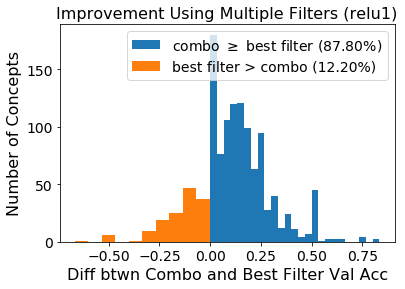

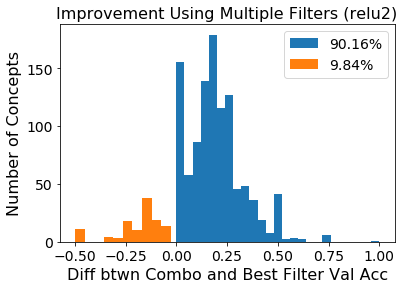

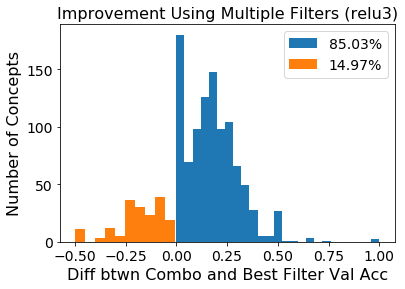

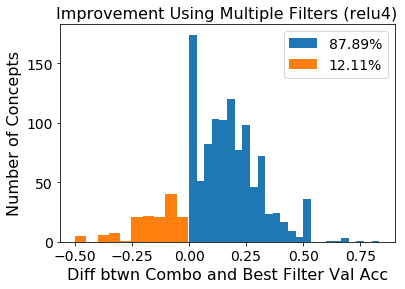

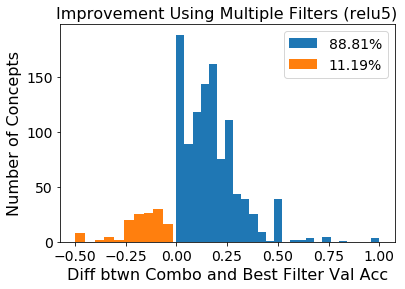

In [63]:
for blob in blobs:
    idx = np.where(np.isfinite(disc_results[blob][1:,1,-1,-1]))[0]
    #print len(idx)
    linear_accs = disc_results[blob][1:,1,-1,-1][idx]
    single_accs = disc_results[blob][1:,0,-1,-1][idx]
    diff = linear_accs - single_accs

    f, ax = plt.subplots(1,1)
    if blob == blobs[0]:
        ax.hist(diff[diff >= 0], bins=25, label='combo $\geq$ best filter (%.2f%%)' % (100*np.sum(diff >= 0)/float(len(diff))))
        ax.hist(diff[diff < 0], bins=10, label='best filter > combo (%.2f%%)' % (100-100*np.sum(diff >= 0)/float(len(diff))))
    else:
        ax.hist(diff[diff >= 0], bins=25, label='%.2f%%' % (100*np.sum(diff >= 0)/float(len(diff))))
        ax.hist(diff[diff < 0], bins=10, label='%.2f%%' % (100-100*np.sum(diff >= 0)/float(len(diff))))

    ax.legend()
    ax.set_xlabel('Diff btwn Combo and Best Filter Val Acc')
    ax.set_ylabel('Number of Concepts')
    ax.set_title('Improvement Using Multiple Filters (%s)' % (blob_names[blob]))
    plt.show()

In [218]:
np.where(linear_set_ious_num_filters[:,0] > 0)[0]

array([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,   10,
         11,   12,   13,   14,   15,   16,   17,   18,   20,   21,   22,
         23,   24,   25,   26,   28,   29,   30,   31,   32,   33,   34,
         35,   37,   39,   40,   41,   42,   43,   44,   45,   46,   47,
         48,   49,   50,   51,   52,   53,   54,   55,   56,   57,   58,
         59,   60,   61,   62,   64,   65,   66,   67,   68,   69,   71,
         72,   73,   74,   75,   76,   77,   78,   79,   80,   81,   82,
         83,   84,   85,   86,   87,   88,   89,   90,   91,   92,   94,
         95,   96,   97,   98,   99,  112,  123,  128,  144,  146,  164,
        167,  172,  184,  188,  198,  203,  205,  207,  208,  243,  244,
        250,  251,  268,  288,  297,  303,  306,  307,  314,  315,  317,
        322,  349,  350,  365,  404,  417,  422,  446,  447,  465,  466,
        472,  476,  479,  495,  497,  514,  521,  524,  527,  528,  531,
        536,  537,  538,  545,  552,  557,  566,  5

592


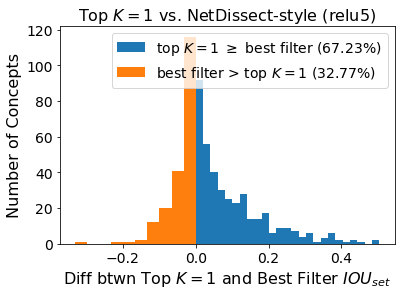

In [220]:
blob = 'features.11'

idx = np.array([i for i in range(len(pc)) if pc[i] < 4 and pc[i] >= 0 and (i >= 100 or i in voc_labels.values())])
#idx = np.array([i for i in range(len(pc)) if pc[i] < 4 and pc[i] > 0 and i in np.where(linear_set_ious_num_filters[:,0] > 0)[0]])
print len(idx)

best_filters = np.argmax(single_set_train_ious[blob], axis=1)
best_set_ious = np.array([single_set_val_ious[blob][idx[i]][best_filters[idx[i]]] for i in range(len(idx))])
set_iou_diff = linear_set_ious[blob][idx] - linear_set_ious_num_filters[idx,0]

f, ax = plt.subplots(1,1)
ax.hist(set_iou_diff[set_iou_diff >= 0], bins=25, label='top $K=1$ $\geq$ best filter (%.2f%%)' % (100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))
ax.hist(set_iou_diff[set_iou_diff < 0], bins=10, label='best filter > top $K=1$ (%.2f%%)' % (100-100*np.sum(set_iou_diff >= 0)/float(len(set_iou_diff))))

ax.legend()
ax.set_xlabel('Diff btwn Top $K=1$ and Best Filter $IOU_{set}$')
ax.set_ylabel('Number of Concepts')
ax.set_title('Top $K=1$ vs. NetDissect-style (%s)' % (blob_names[blob]))
plt.show()

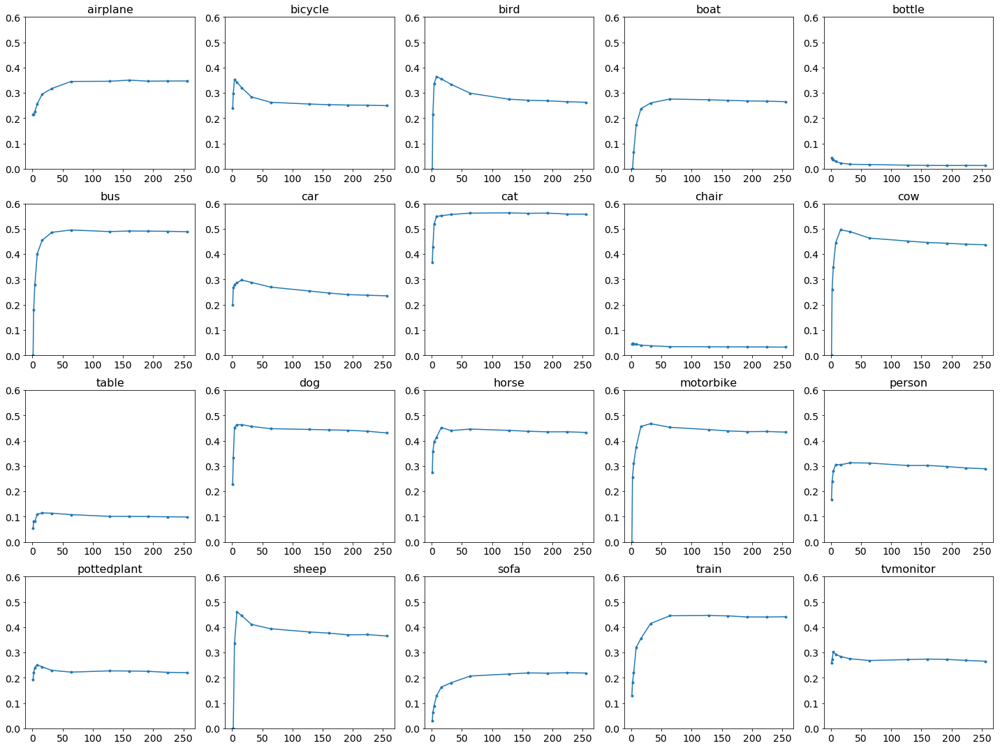

In [205]:
blob = 'features.11'

num_filters = np.array([1, 2, 4, 8, 16, 32, 64, 128,160,192,224])

filters_range = np.concatenate((num_filters, [256]))

f, ax = plt.subplots(4,5,figsize=(20,15))

for i in range(len(voc_labels)):
    voc_label = voc_labels.keys()[i]
    voc_i = voc_labels[voc_label]
    ax[i/5][i%5].plot(filters_range, linear_set_ious_num_filters[voc_i,:], '.-')
    ax[i/5][i%5].set_title(voc_label)
    ax[i/5][i%5].set_ylim([0.0,0.6])
    ax[i/5][i%5].set_xticks(range(0,275,50))
plt.tight_layout()
plt.show()

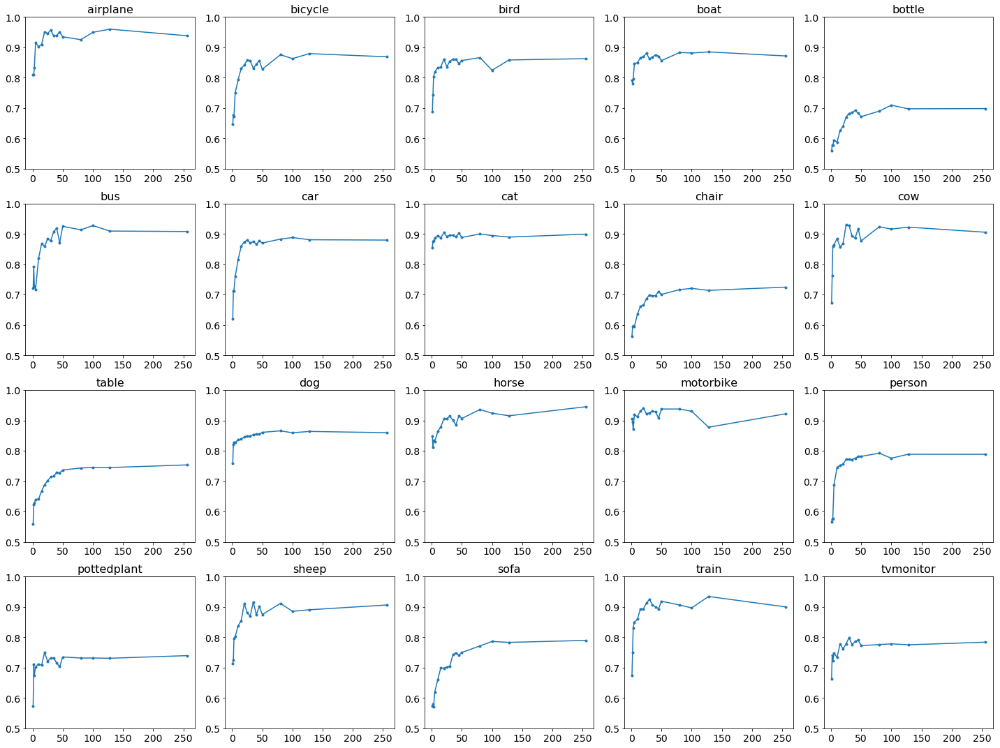

In [190]:
blob = 'features.11'

num_filters = [1, 2, 3, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 80, 100, 128]

filters_range = np.concatenate((num_filters, [256]))

f, ax = plt.subplots(4,5,figsize=(20,15))

for i in range(len(voc_labels)):
    voc_label = voc_labels.keys()[i]
    voc_i = voc_labels[voc_label]
    ax[i/5][i%5].plot(filters_range, disc_results_all[blob][voc_i,:,-1,-1], '.-')
    ax[i/5][i%5].set_title(voc_label)
    ax[i/5][i%5].set_ylim([0.5,1.0])
    ax[i/5][i%5].set_xticks(range(0,275,50))
plt.tight_layout()
plt.show()

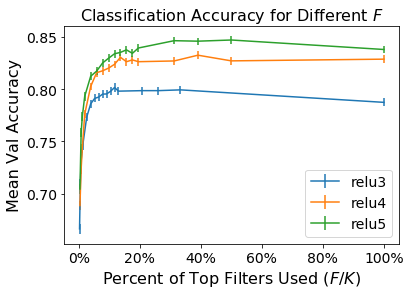

In [211]:
num_filters = [1, 2, 3, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 80, 100, 128]

f, ax = plt.subplots(1,1)
for blob in blobs[2:]:
    blob_info = ed.load_info(blob=blob)
    filters_range = np.concatenate((num_filters, [blob_info.shape[1]]))
    x = disc_results_all[blob][:, :, -1, -1]
    ax.errorbar(np.true_divide(filters_range, blob_info.shape[1]), np.mean(x[np.isfinite(x[:,-1])], axis=0), 
                yerr=np.std(x[np.isfinite(x[:,-1])], axis=0)/np.sqrt(np.sum(np.isfinite(x[:,-1]))), label=blob_names[blob])
ax.set_title(r'Classification Accuracy for Different $F$')
ax.set_xlabel(r'Percent of Top Filters Used ($F/K$)')
ax.set_ylabel('Mean Val Accuracy')
formatter = FuncFormatter(to_percent)
plt.gca().xaxis.set_major_formatter(formatter)
ax.legend()
#plt.ylim([0.5, 1.0])
plt.show()

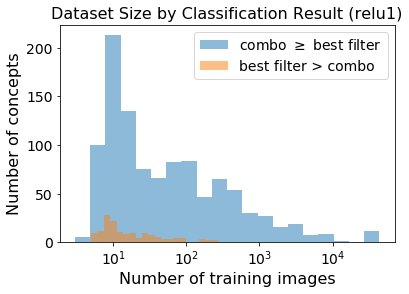

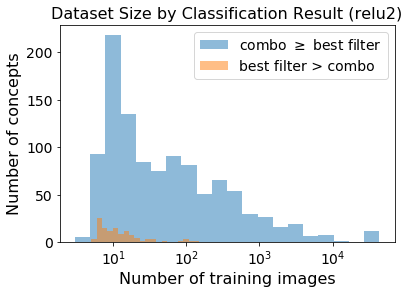

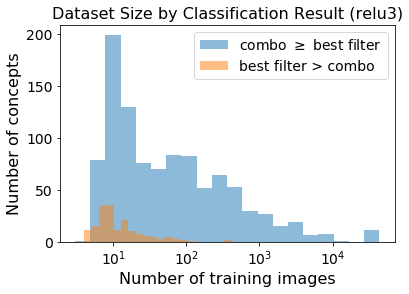

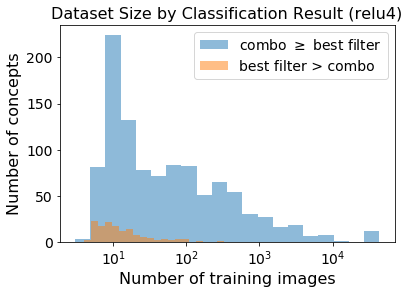

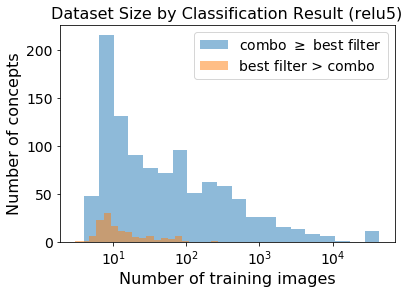

In [221]:
blob = 'features.11'

for blob in blobs:
    x = disc_results[blob][:,1,-1,-1]
    y = disc_results[blob][:,0,-1,-1]
    label_names[np.where(x < y)[0]]

    idx = np.where(np.isfinite(x))[0]
    curr_small = np.where(x[idx] < y[idx])[0]
    curr_big = np.where(x[idx] >= y[idx])[0]

    imgs_per_class = np.sum(image_to_label[train_ind,:], axis=0)

    f, ax = plt.subplots(1,1)
    ax.hist(np.log10(imgs_per_class[idx[curr_big]]), bins=20, alpha=0.5, label=r'combo $\geq$ best filter')
    ax.hist(np.log10(imgs_per_class[idx[curr_small]]), bins=20, alpha=0.5, label='best filter > combo')
    #ax.plot(1-alphas[idx[curr_small]], imgs_per_class[curr_small], '.')
    ax.legend()
    ax.set_ylabel('Number of concepts')
    ax.set_xlabel('Number of training images')
    ax.set_xticklabels([r'$10^{%d}$' % i for i in range(5)])
    ax.set_title("Dataset Size by Classification Result (%s)" % (blob_names[blob]))
    plt.show()

## Filter Coding for Multiple Concepts

In [18]:
blob = 'features.11'
iou_thresh = 0.15
single_survives_thresh = np.minimum(single_set_train_ious[blob] > iou_thresh, single_set_val_ious[blob] > iou_thresh)

In [224]:
for i in np.where(np.sum(single_survives_thresh, axis=0) > 1)[0]:
    unit_classes = np.where(single_survives_thresh[:,i])[0]
    print 'unit %d:' % i,', '.join(['%s (%.4f)' % (label_names[j], single_set_val_ious[blob][j][i]) for j in unit_classes])
    

unit 15: dotted (0.3710), perforated (0.2505), polka-dotted (0.4716), studded (0.1956), honeycombed (0.4169), chequered (0.3171)
unit 30: horse (0.1775), cow (0.1576), elephant (0.3050)
unit 32: pool table (0.2570), swimming pool (0.3088), aquarium (0.2629)
unit 55: washer (0.1762), tunnel (0.2126)
unit 66: horse (0.2088), sheep (0.2126), cow (0.1968)
unit 109: dog (0.1877), cat (0.1729)
unit 111: screen (0.1671), tvmonitor (0.1736), monitor (0.1545), silver screen (0.2389)
unit 114: dotted (0.2740), polka-dotted (0.2679)
unit 130: dog (0.1531), cat (0.2561)
unit 176: dog (0.1939), cat (0.1694), sheep (0.2008)
unit 206: aqueduct (0.1515), viaduct (0.1734)
unit 248: bicycle (0.1801), swirly (0.1842), paisley (0.1510), steering wheel (0.1531), labyrinth (0.2816)
unit 255: banded (0.1995), striped (0.3436), zigzagged (0.1726)


15 6 [u'dotted' u'perforated' u'polka-dotted' u'studded' u'honeycombed'
 u'chequered']
[ 0.34838182  0.20769937  0.39672866  0.19430514  0.27456284  0.2808173 ]


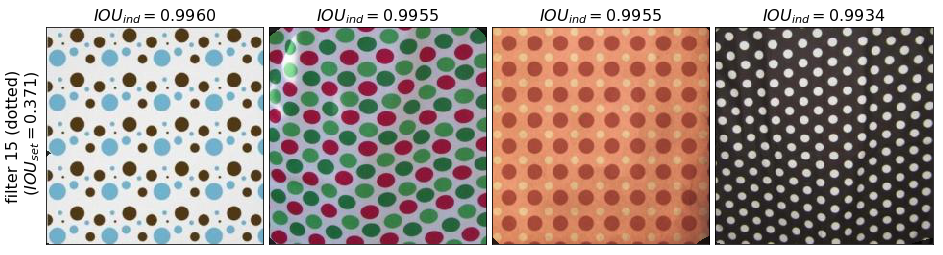

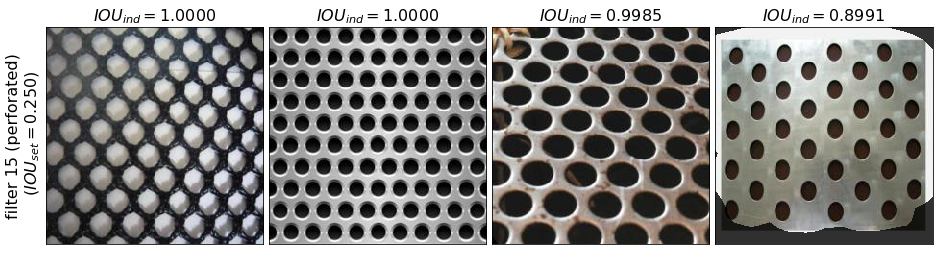

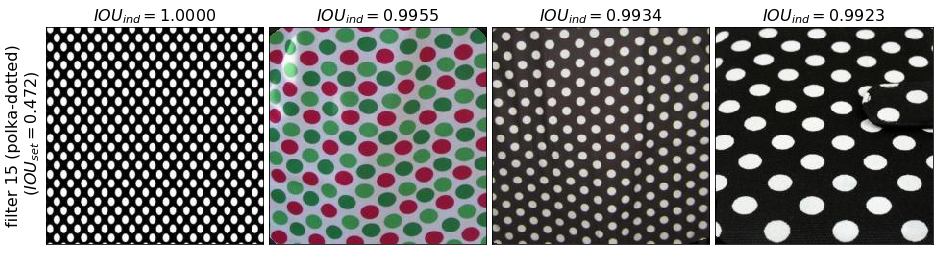

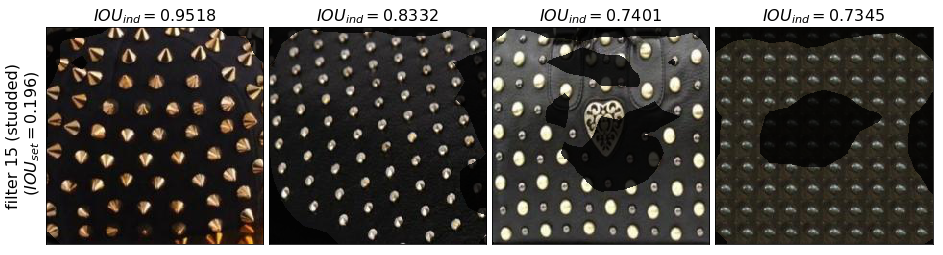

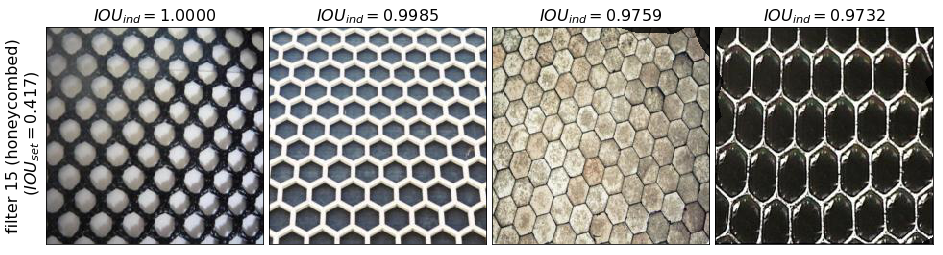

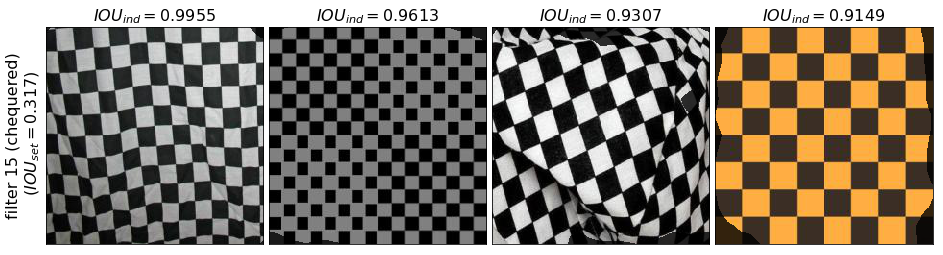

30 3 [u'horse' u'cow' u'elephant']
[ 0.18485287  0.17072152  0.17438424]


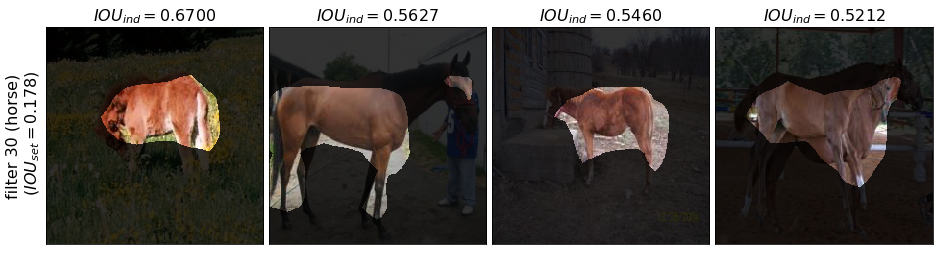

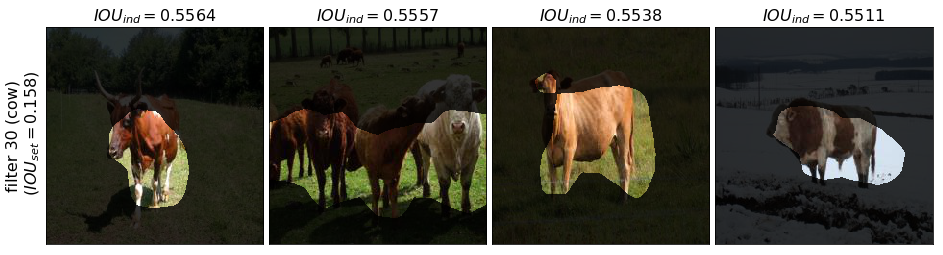

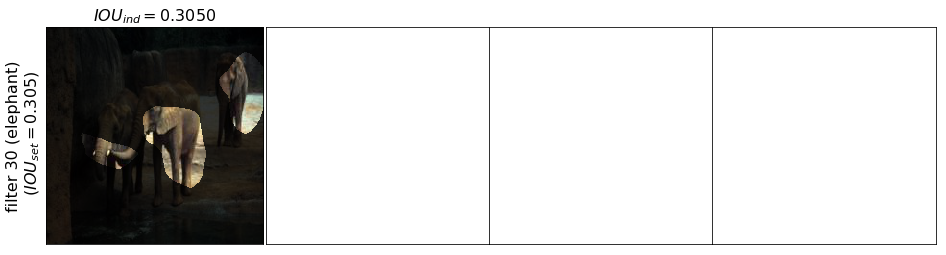

32 3 [u'pool table' u'swimming pool' u'aquarium']
[ 0.2566945   0.21792157  0.2027456 ]


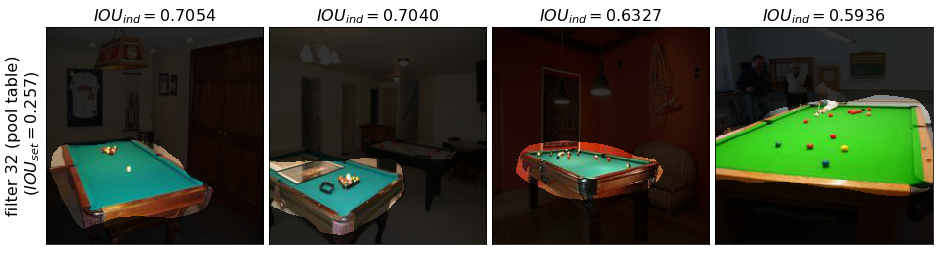

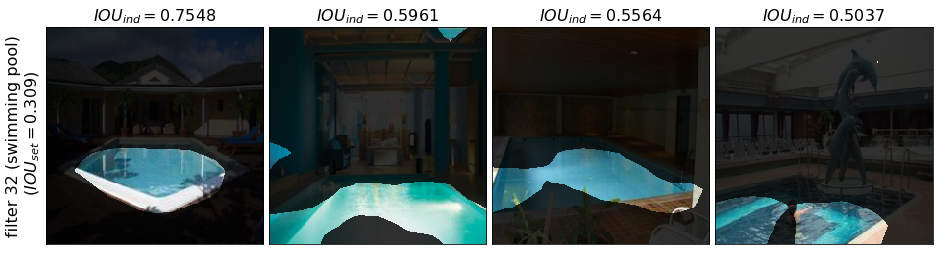

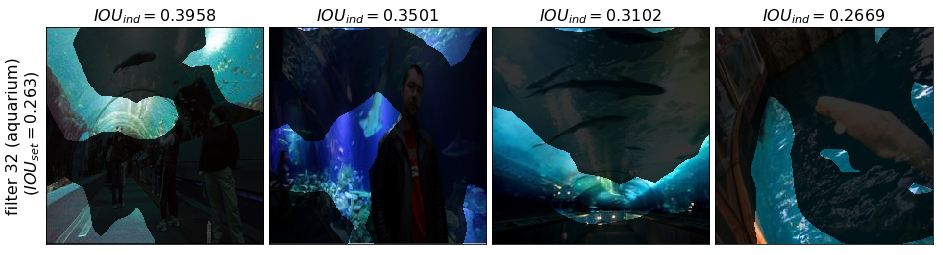

55 2 [u'washer' u'tunnel']
[ 0.1850177   0.16298911]


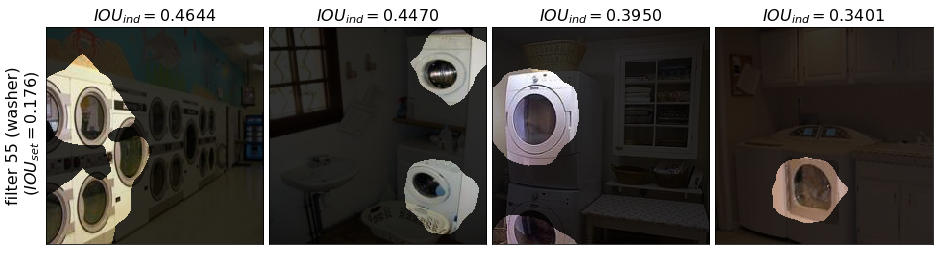

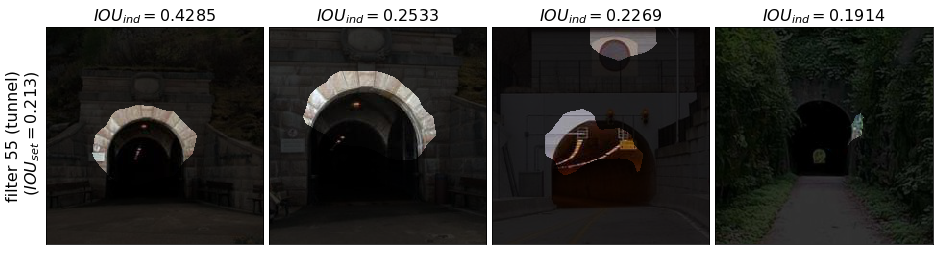

66 3 [u'horse' u'sheep' u'cow']
[ 0.20543994  0.18869136  0.19485529]


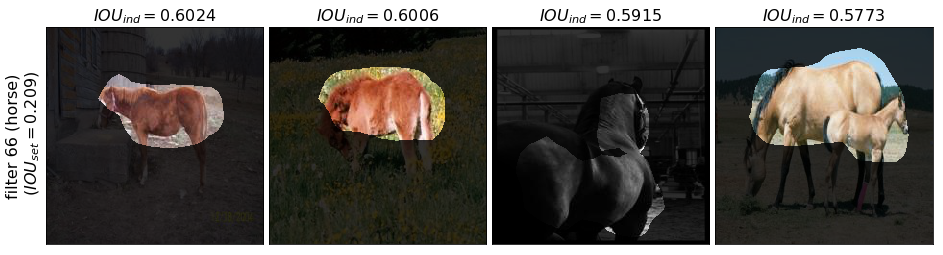

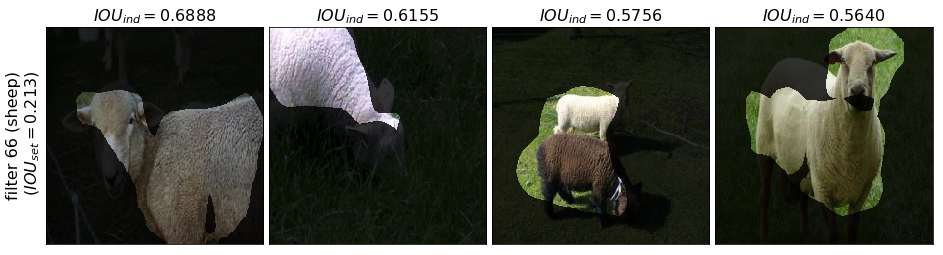

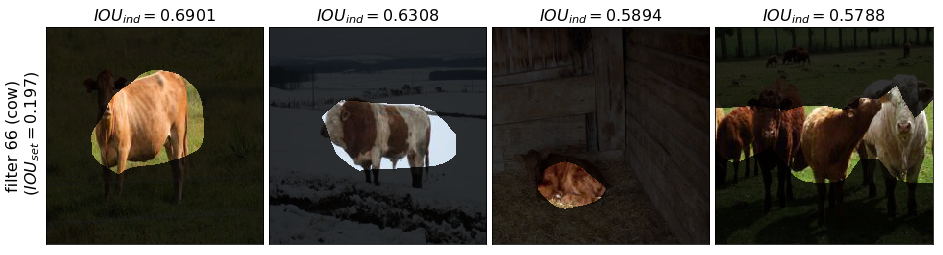

109 2 [u'dog' u'cat']
[ 0.17483428  0.16156161]


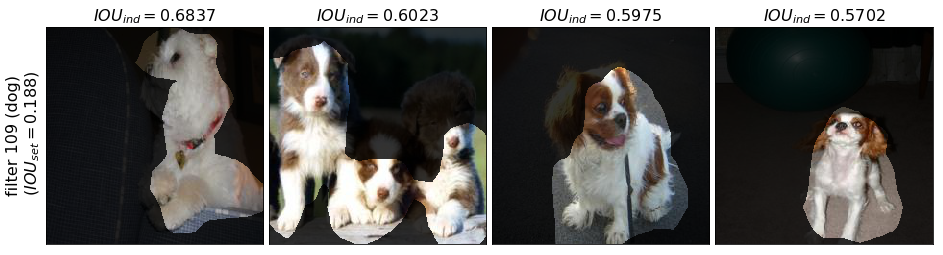

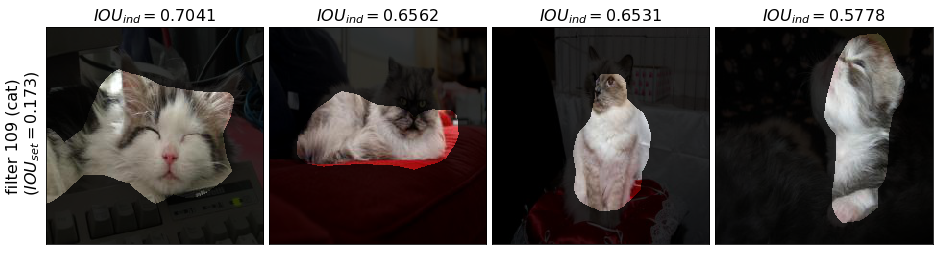

111 4 [u'screen' u'tvmonitor' u'monitor' u'silver screen']
[ 0.17766836  0.17925455  0.16397892  0.1607566 ]


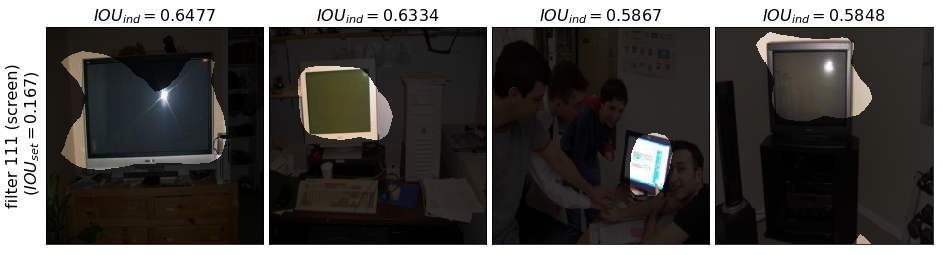

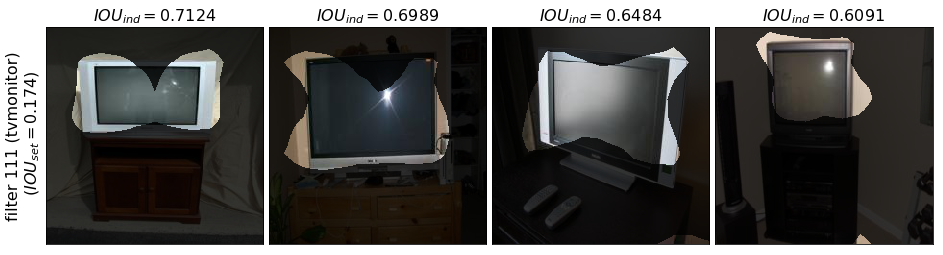

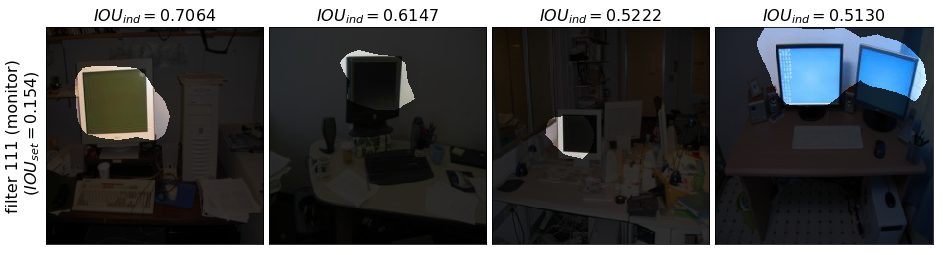

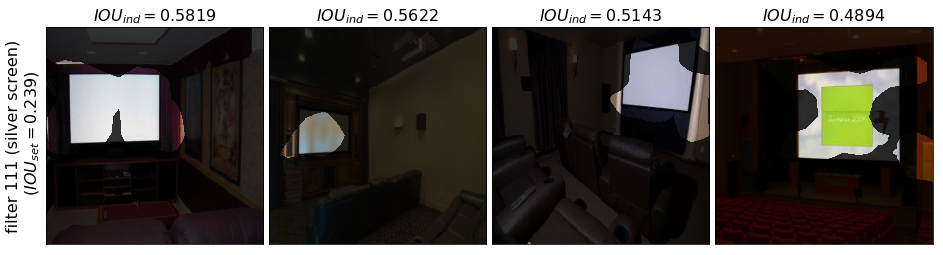

114 2 [u'dotted' u'polka-dotted']
[ 0.35684773  0.40803367]


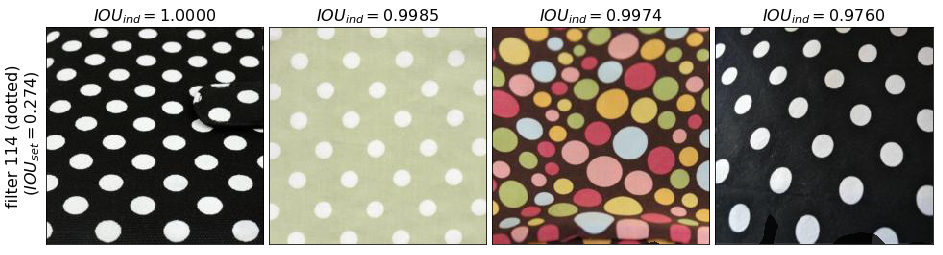

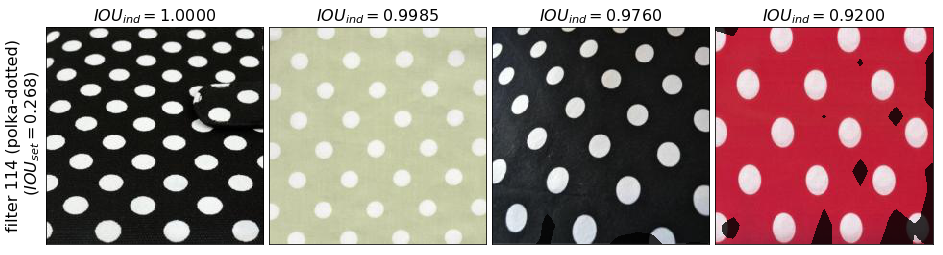

130 2 [u'dog' u'cat']
[ 0.16324343  0.25069788]


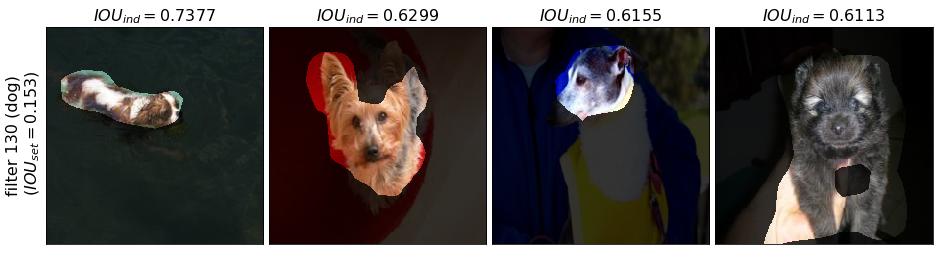

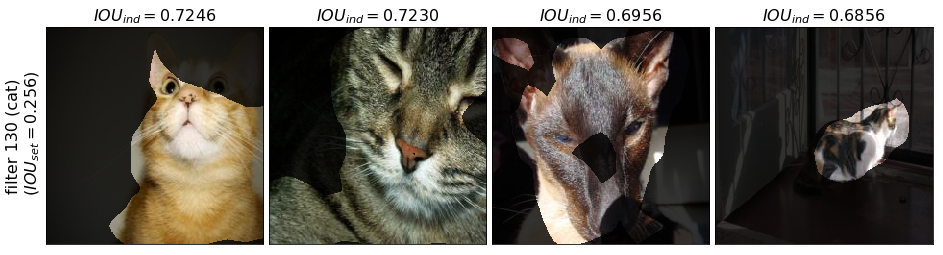

176 3 [u'dog' u'cat' u'sheep']
[ 0.1927349   0.17875479  0.23133568]


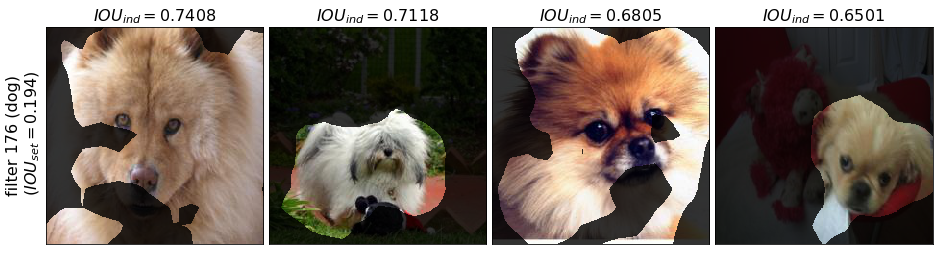

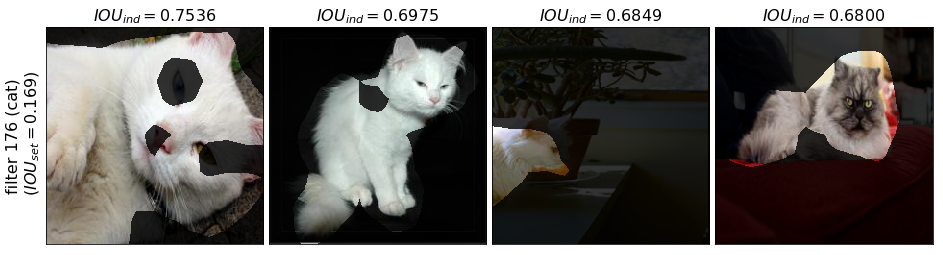

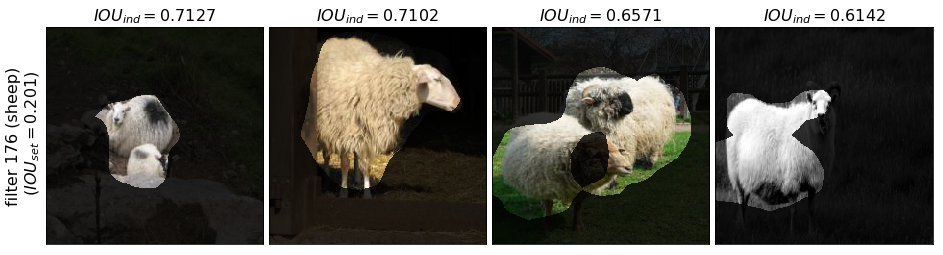

206 2 [u'aqueduct' u'viaduct']
[ 0.22908083  0.16474797]


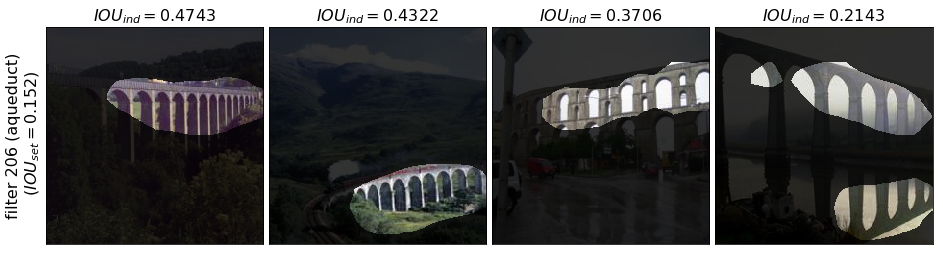

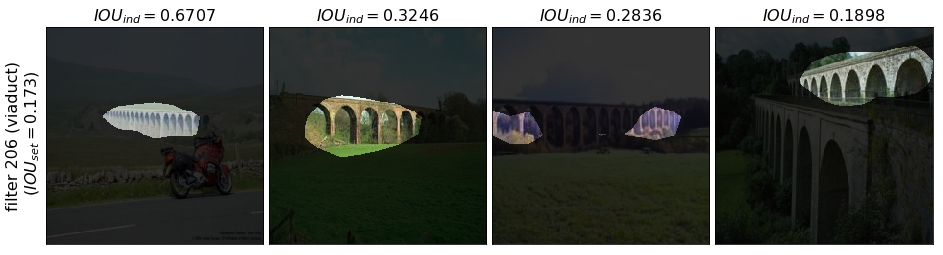

248 5 [u'bicycle' u'swirly' u'paisley' u'steering wheel' u'labyrinth']
[ 0.15591261  0.18826498  0.22798863  0.19153814  0.26063481]


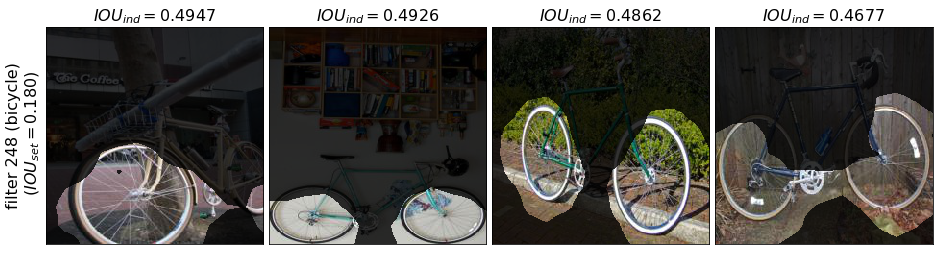

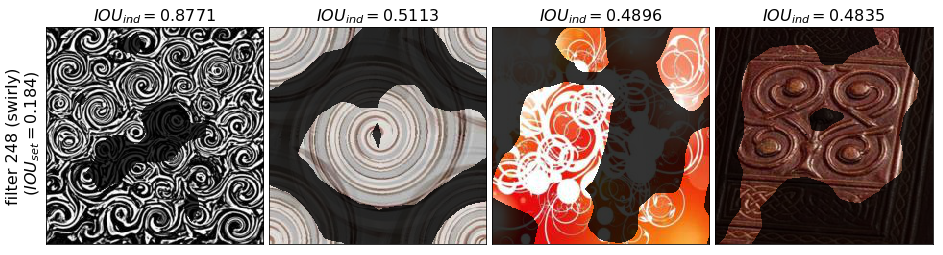

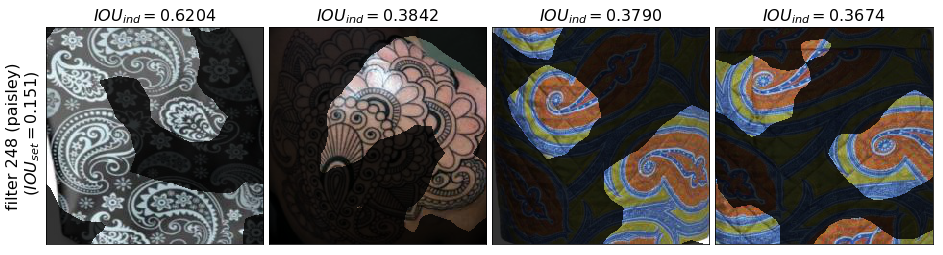

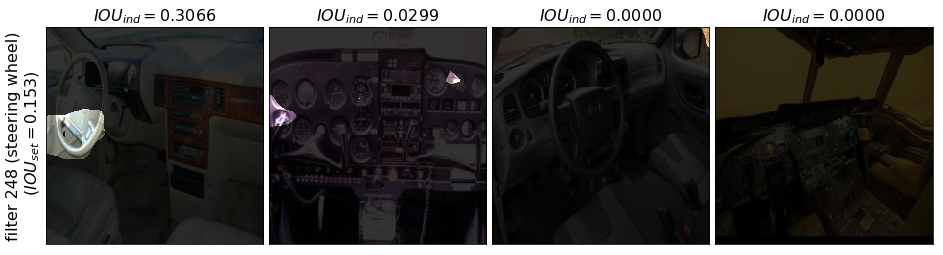

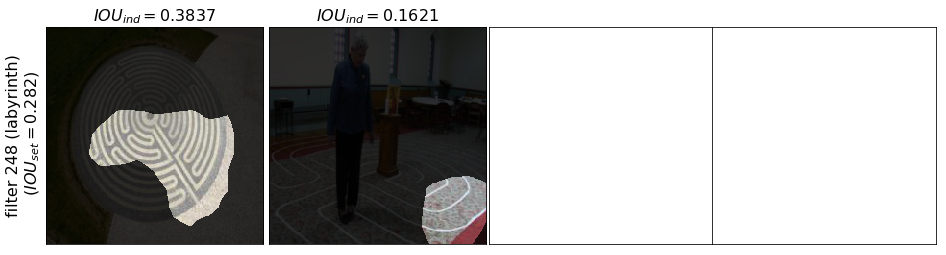

255 3 [u'banded' u'striped' u'zigzagged']
[ 0.16997984  0.24578205  0.19167469]


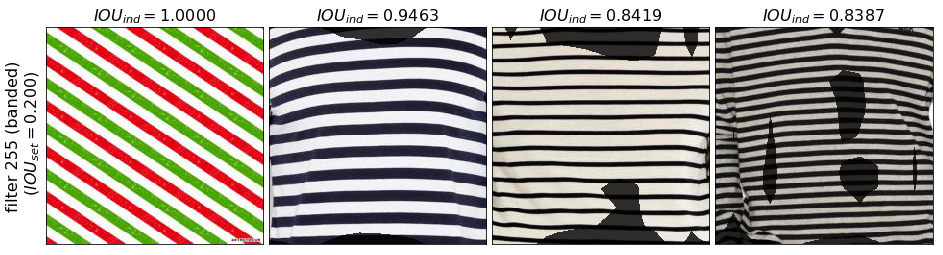

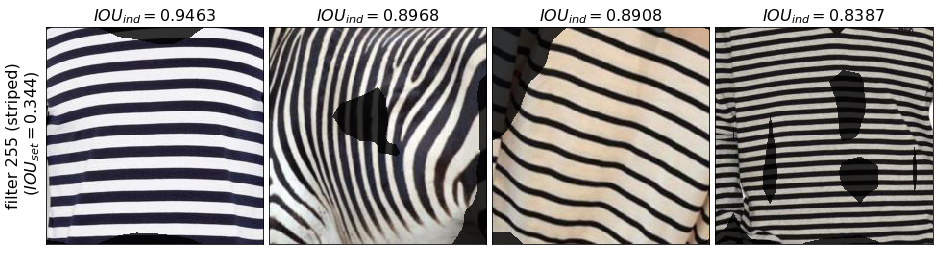

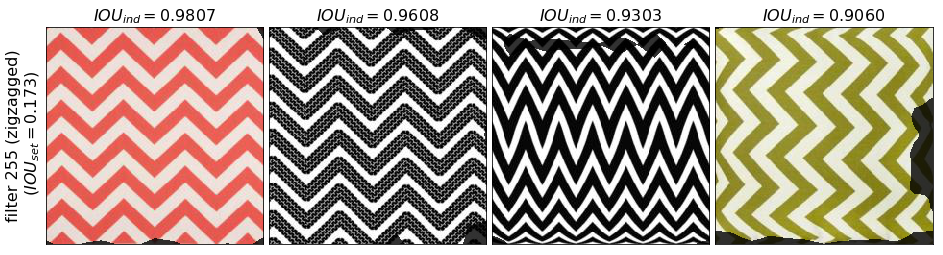

In [30]:
interested_idx = np.where(np.sum(single_survives_thresh, axis=0) > 1)[0]
#interested_idx = [30,66]
num_top = 4
mask_alpha = 0.2
for unit in interested_idx:
    unit_classes = np.where(single_survives_thresh[:,unit])[0]
    print unit, np.sum(single_survives_thresh[:,unit]), label_names[unit_classes]
    print single_set_train_ious[blob][unit_classes,unit]
    #show_examples_for_unit(blob, unit, top[blob][unit], up_size=info.input_dim, num_to_show=8, mask_alpha=0.2, 
    #                       thresh_first=False)
    for unit_class in unit_classes:
        example_idx = np.where(val_ind & image_to_label[:,unit_class])[0]
        top_idx = np.argsort(single_ind_ious[blob][unit_class,example_idx,unit])[::-1][:num_top]
        f, ax = plt.subplots(1,num_top,figsize=(4*num_top,4))
        for i in range(num_top):
            ax[i].set_xticks([])
            ax[i].set_yticks([])
            try:
                up = get_single_acts(np.expand_dims(blobdata[blob][example_idx[top_idx[i]]], axis=0), thresh[blob], unit, 
                                     up_size=info.input_dim, 
                                     thresh_first=False)
            except:
                #print example_idx[top_idx[i]], unit
                continue
            ax[i].imshow((np.expand_dims((up > 0.5), axis=2) * (1-mask_alpha) + mask_alpha) * imread(ds.filename(example_idx[top_idx[i]]))/255.)
            ax[i].set_title(r'$IOU_{ind} = %.4f$' % single_ind_ious[blob][unit_class,example_idx[top_idx[i]],unit])
            if i == 0:
                ax[i].set_ylabel('filter %d (%s)\n ($IOU_{set} = %.3f$)' % (unit, label_names[unit_class], 
                                                                           single_set_val_ious[blob][unit_class][unit]))
        f.subplots_adjust(wspace=0.0,hspace=0.0)
        #plt.tight_layout()
        plt.show()

15 6 [u'polka-dotted' u'honeycombed' u'dotted' u'chequered' u'perforated'
 u'studded']
[ 0.47159612  0.41693947  0.37103635  0.31708434  0.25049052  0.19563004]


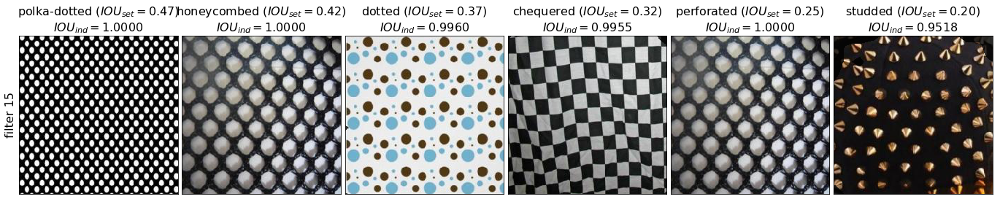

30 3 [u'elephant' u'horse' u'cow']
[ 0.30495271  0.17754288  0.1575522 ]


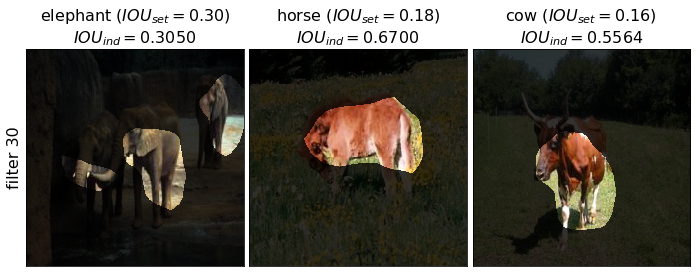

32 3 [u'swimming pool' u'aquarium' u'pool table']
[ 0.30883628  0.26286733  0.25699085]


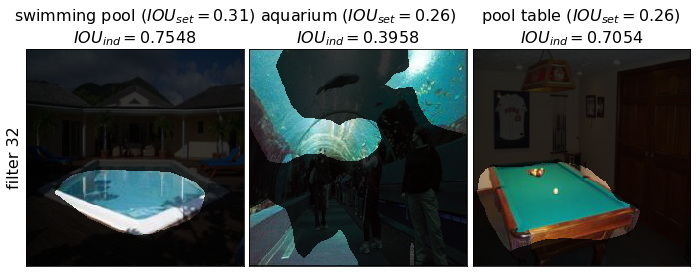

55 2 [u'tunnel' u'washer']
[ 0.21261275  0.1762291 ]


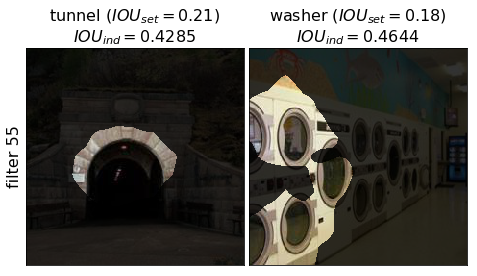

66 3 [u'sheep' u'horse' u'cow']
[ 0.21258287  0.20875531  0.19675352]


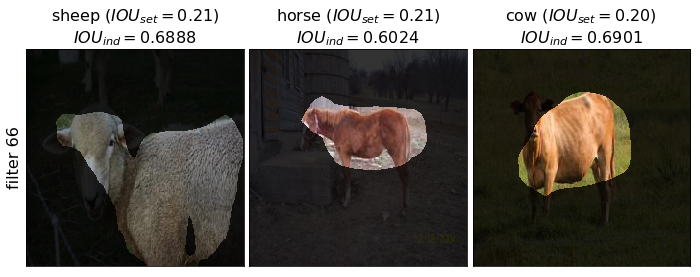

109 2 [u'dog' u'cat']
[ 0.1877117   0.17293775]


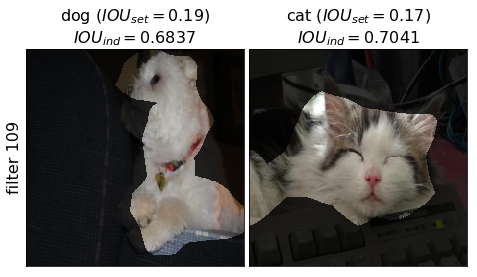

111 4 [u'silver screen' u'tvmonitor' u'screen' u'monitor']
[ 0.2389414   0.17362709  0.1671437   0.15449467]


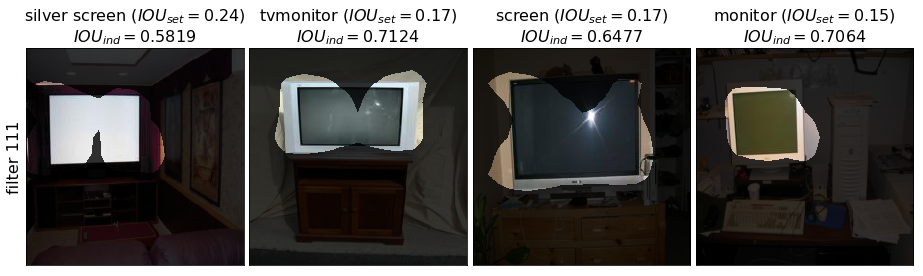

114 2 [u'dotted' u'polka-dotted']
[ 0.2740055   0.26790178]


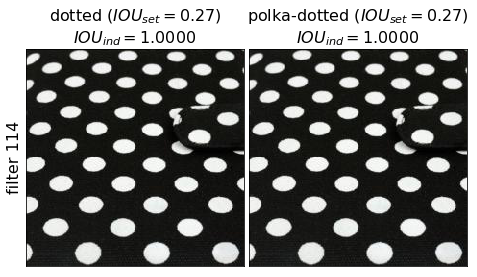

130 2 [u'cat' u'dog']
[ 0.25614348  0.15310955]


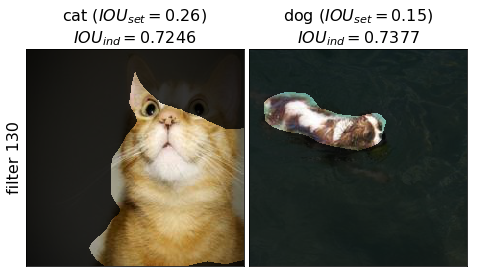

176 3 [u'sheep' u'dog' u'cat']
[ 0.2008017   0.19389549  0.16935822]


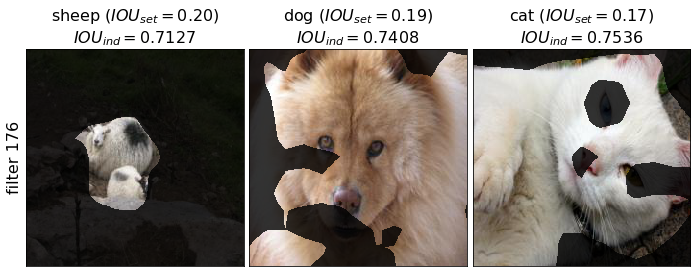

206 2 [u'viaduct' u'aqueduct']
[ 0.17343237  0.151522  ]


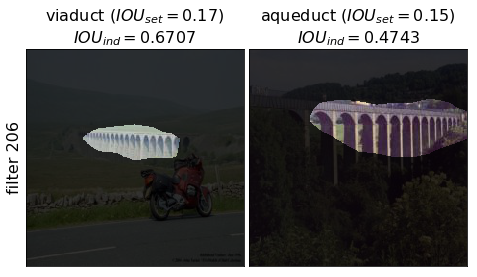

248 5 [u'labyrinth' u'swirly' u'bicycle' u'steering wheel' u'paisley']
[ 0.28160623  0.18420023  0.18013915  0.15309957  0.15101203]


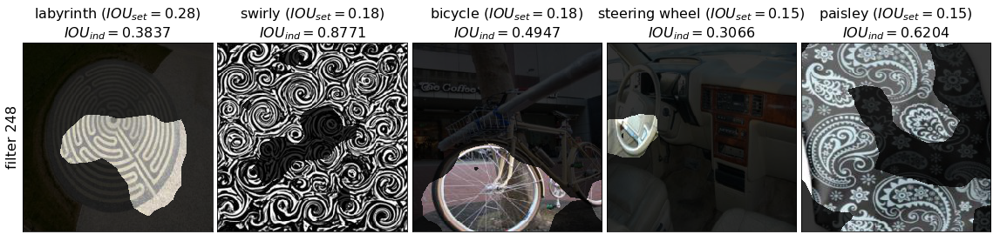

255 3 [u'striped' u'banded' u'zigzagged']
[ 0.34361395  0.19952188  0.17259994]


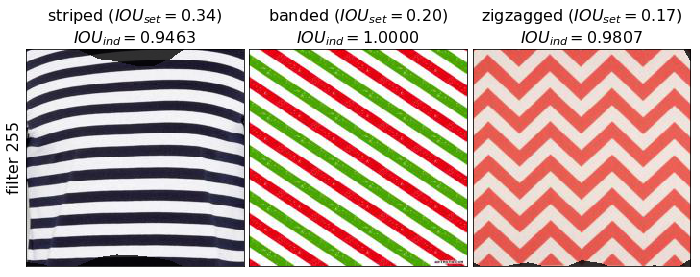

In [36]:
interested_idx = np.where(np.sum(single_survives_thresh, axis=0) > 1)[0]
#interested_idx = [30,66]
num_top = 4
mask_alpha = 0.2
for unit in interested_idx:
    unit_classes = np.where(single_survives_thresh[:,unit])[0]
    sorted_idx = np.argsort(single_set_val_ious[blob][unit_classes,unit])[::-1]
    unit_classes = unit_classes[sorted_idx]
    print unit, np.sum(single_survives_thresh[:,unit]), label_names[unit_classes]
    print single_set_val_ious[blob][unit_classes,unit]
    f, ax = plt.subplots(1,len(unit_classes),figsize=(4*len(unit_classes),4))
    for i in range(len(unit_classes)):
        unit_class = unit_classes[i]
        example_idx = np.where(val_ind & image_to_label[:,unit_class])[0]
        top_idx = np.argsort(single_ind_ious[blob][unit_class,example_idx,unit])[::-1][:num_top]
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        try:
            up = get_single_acts(np.expand_dims(blobdata[blob][example_idx[top_idx[0]]], axis=0), thresh[blob], unit, 
                                 up_size=info.input_dim, 
                                 thresh_first=False)
        except:
            #print example_idx[top_idx[i]], unit
            continue
        ax[i].imshow((np.expand_dims((up > 0.5), axis=2) * (1-mask_alpha) + mask_alpha) * imread(ds.filename(example_idx[top_idx[0]]))/255.)
        ax[i].set_title('%s ($IOU_{set} = %.2f$)\n$IOU_{ind} = %.4f$' % (label_names[unit_class], 
                                                                       single_set_val_ious[blob][unit_class][unit],
                                                                       single_ind_ious[blob][unit_class,example_idx[top_idx[0]],unit]))
        if i == 0:
            ax[i].set_ylabel('filter %d' % unit)
    f.subplots_adjust(wspace=0.0,hspace=0.0)
    #plt.tight_layout()
    plt.show()

In [111]:
label_names[np.where(best_filters_count >= 20)[0]]

array([u'black-c'],
      dtype='<U29')

In [119]:
single_set_val_ious[blob].shape

(1198, 64)

relu1


9 [u'folding door (0.0270)', u'grille door (0.0211)', u'organ (0.0185)', u'scaffolding (0.0167)', u'bookcase (0.0136)', u'altarpiece (0.0134)', u'shops (0.0133)', u'balcony (0.0130)', u'elevator (0.0116)', u'coach (0.0101)', u'railing (0.0086)', u'shutter (0.0083)', u'refrigerator (0.0080)', u'vase (0.0075)', u'sales booth (0.0073)', u'coat (0.0072)', u'bird cage (0.0063)', u'lamp (0.0062)', u'basket (0.0061)', u'chest of drawers (0.0051)', u'cart (0.0042)', u'handle (0.0018)', u'saucepan (0.0015)', u'drum (0.0003)']


17 [u'silver screen (0.0258)', u'covered bridge (0.0237)', u'wing (0.0199)', u'coach roof (0.0198)', u'desk (0.0182)', u'airplane (0.0169)', u'caravan (0.0161)', u'fireplace (0.0147)', u'sandbox (0.0118)', u'mezzanine (0.0113)', u'pier (0.0107)', u'system (0.0088)', u'computer (0.0088)', u'apron (0.0082)', u'player (0.0074)', u'niche (0.0069)', u'granite (0.0063)', u'metal (0.0062)', u'plane (0.0060)', u'saddle (0.0056)', u'computer case (0.0034)', u'forest (0.00

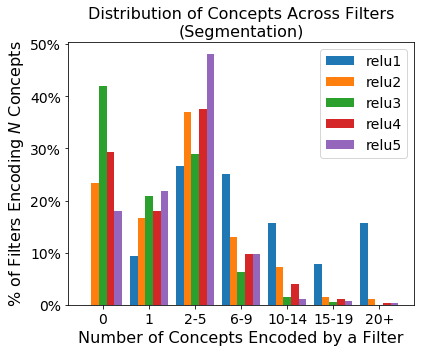

In [192]:
f, ax = plt.subplots(1,1,figsize=(6,5))

ranges = [(0,0), (1,1), (2,5), (6,9), (10,14), (15,19),(20, np.inf)]
idx = np.arange(len(ranges))
width = 1/float(len(blobs)+1)

label_idx = np.array([i for i in range(len(pc)) if (pc[i] < 4 and pc[i] >= 0)])

j = 0
for blob in blobs:
    print blob_names[blob]
    blob_info = ed.load_info(blob=blob)
    K = blob_info.shape[1]
    best_filters = single_set_train_ious[blob].argmax(axis=1)[label_idx]
    best_filters_count = np.zeros(K)
    for f in range(K):
        best_filters_count[f] = np.sum(best_filters == f)
        if best_filters_count[f] >= 20: 
            idx_ = np.where(best_filters == f)[0]
            idx_ = idx_[np.argsort(single_set_val_ious[blob][label_idx[idx_],f])[::-1]]
            print '\n'
            print f, ['%s (%.4f)' % (label_names[label_idx[i]], single_set_val_ious[blob][label_idx[i],f]) for i in idx_]
    ax.bar(idx + j*width, [np.sum(np.logical_and(best_filters_count >= r[0], 
                                         best_filters_count <= r[1]))/float(K) for r in ranges], 
           width, label=blob_names[blob])
    j += 1
ax.legend()
ax.set_title('Distribution of Concepts Across Filters\n(Segmentation)')
ax.set_xticks(idx+width*(len(blobs)-1)/2.)
ax.set_xticklabels(['0','1','2-5','6-9','10-14','15-19','20+'])
ax.set_xlabel('Number of Concepts Encoded by a Filter')
ax.set_ylabel('% of Filters Encoding $N$ Concepts')
formatter = FuncFormatter(to_percent)
plt.gca().yaxis.set_major_formatter(formatter)
plt.tight_layout()
plt.show()

In [132]:
disc_results[blob].shape

(1198, 2, 4, 30)

relu1
13
relu2
17
relu3
10
relu4
16
relu5
10


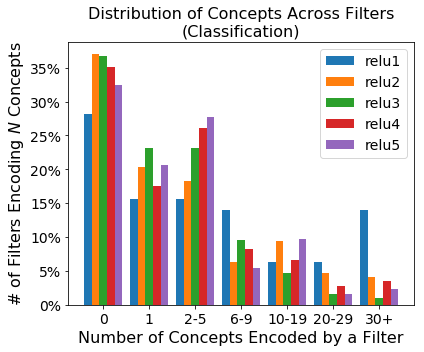

In [194]:
f, ax = plt.subplots(1,1,figsize=(6,5))

ranges = [(0,0), (1,1), (2,5), (6,9), (10,19), (20,29),(30, np.inf)]
idx = np.arange(len(ranges))
width = 1/float(len(blobs)+1)

j = 0
for blob in blobs:
    print blob_names[blob]
    blob_info = ed.load_info(blob=blob)
    K = blob_info.shape[1]
    disc_best_filters = np.abs(disc_weights[blob][1:,-1,:]).argmax(axis=1)
    disc_best_filters_count = np.zeros(K)
    for f in range(K):
        disc_best_filters_count[f] = np.sum(disc_best_filters == f)
        if disc_best_filters_count[f] >= 20: 
            idx_ = np.where(disc_best_filters == f)[0]
            idx_ = idx_[np.argsort(disc_results[blob][idx_,0,-1,-1])[::-1]]
            #print ['%s (%.2f)' % (label_names[i], disc_results[blob][i,0,-1,-1]) for i in idx_]
    print np.sum(disc_best_filters_count >= 20)
    ax.bar(idx + j*width, [np.sum(np.logical_and(disc_best_filters_count >= r[0], 
                                         disc_best_filters_count <= r[1]))/float(K) for r in ranges], 
           width, label=blob_names[blob])
    #ax.bar(idx + j*width, np.concatenate(([np.sum(disc_best_filters_count == i) for i in range(10)],
    #                                      [np.sum(disc_best_filters_count >= 10)])), width, label=blob_names[blob])
    j += 1
#ax.bar(idx+width, mus_single, width, yerr=np.true_divide(sigmas_single, np.sqrt(counts)), label='best filter')
ax.legend()
ax.set_title('Distribution of Concepts Across Filters\n(Classification)')
ax.set_xticks(idx+width*(len(blobs)-1)/2.)
ax.set_xticklabels(['0','1','2-5','6-9','10-19','20-29','30+'])
ax.set_xlabel('Number of Concepts Encoded by a Filter')
ax.set_ylabel('# of Filters Encoding $N$ Concepts')
plt.tight_layout()
formatter = FuncFormatter(to_percent)
plt.gca().yaxis.set_major_formatter(formatter)
plt.show()

## Interpretability

In [79]:
top[blob][best_filter][::-1][:8]

array([51673, 35958, 54591, 39264,  4037, 24456, 40467, 60707])

96


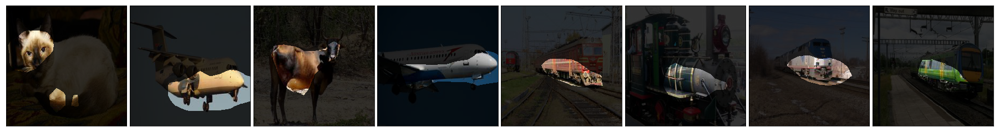

In [91]:
label_i = 185 # train
blob = 'features.11'

best_filter = np.argmax(single_set_train_ious[blob][label_i])
sel_idx = [0,1,8,9,26,27,35,42]
print best_filter
#example_idx = np.where(val_ind & image_to_label[:,unit_class])[0]

show_examples_for_unit(blob, best_filter, top[blob][best_filter][::-1][sel_idx], up_size=info.input_dim, num_to_show=8, mask_alpha=0.2, 
                       thresh_first=False)

In [93]:
print np.where(image_to_label[:,label_i][top[blob][best_filter][::-1]] == 1)[0][:10]

[26 27 35 42 51 52 58 65 67 79]


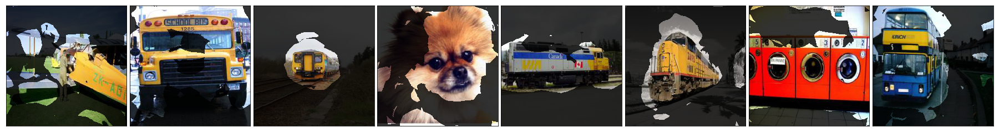

In [101]:
label_i = 185 # train
blob = 'features.11'

#sel_idx = [0,1,8,9,26,27,35,42]
#example_idx = np.where(val_ind & image_to_label[:,label_i])[0]

show_examples_for_linear(blob, weights[blob][label_i], linear_top[label_i,:][::-1], up_size=info.input_dim, num_to_show=8, mask_alpha=0.2, 
                             thresh_first=False)

In [144]:
idx[:12]

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1197
[t-SNE] Computed conditional probabilities for sample 1197 / 1197
[t-SNE] Mean sigma: 2.685648
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.013063
[t-SNE] Error after 200 iterations: 1.013063


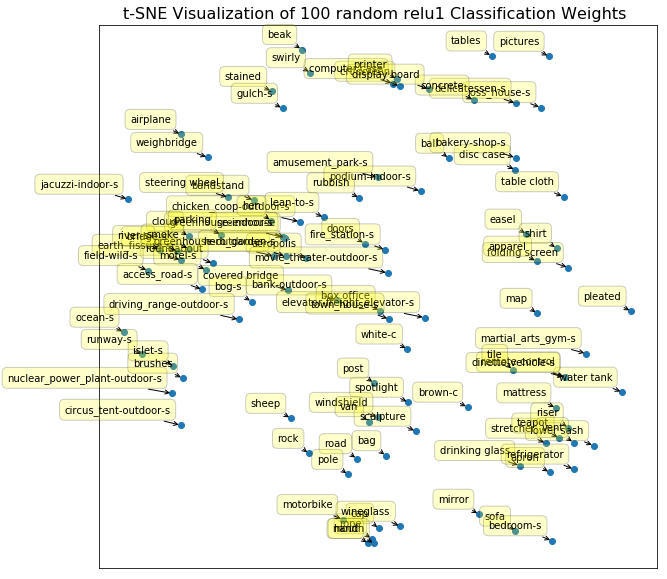

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1197
[t-SNE] Computed conditional probabilities for sample 1197 / 1197
[t-SNE] Mean sigma: 4.205271
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.112081
[t-SNE] Error after 200 iterations: 1.112081


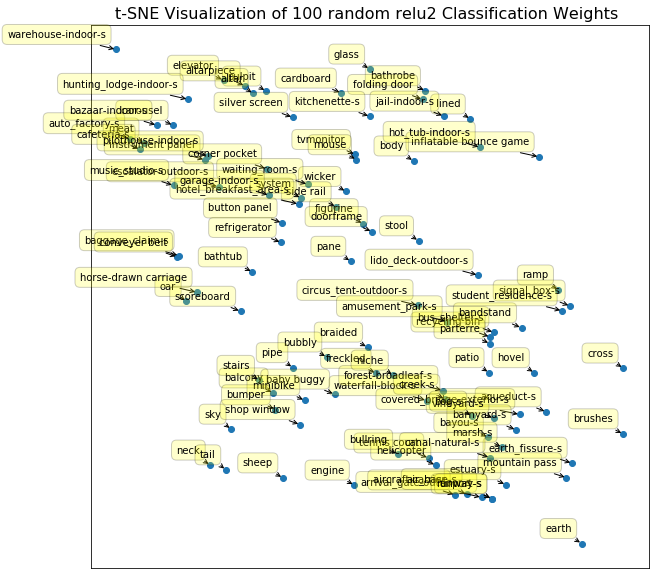

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1197
[t-SNE] Computed conditional probabilities for sample 1197 / 1197
[t-SNE] Mean sigma: 5.946004
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.134243
[t-SNE] Error after 175 iterations: 1.134243


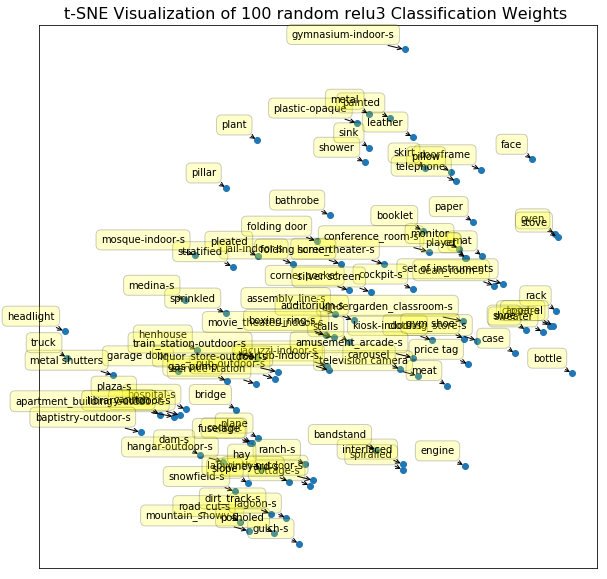

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1197
[t-SNE] Computed conditional probabilities for sample 1197 / 1197
[t-SNE] Mean sigma: 5.318946
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.059699
[t-SNE] Error after 175 iterations: 1.059699


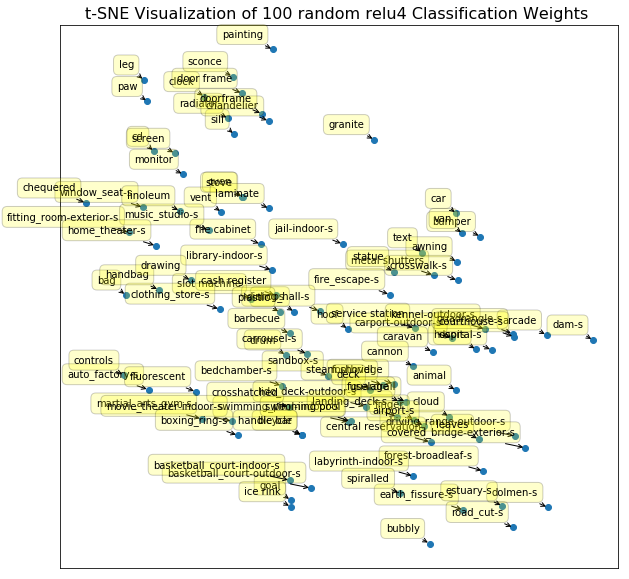

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1197
[t-SNE] Computed conditional probabilities for sample 1197 / 1197
[t-SNE] Mean sigma: 4.645039
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.051707
[t-SNE] Error after 175 iterations: 1.051707


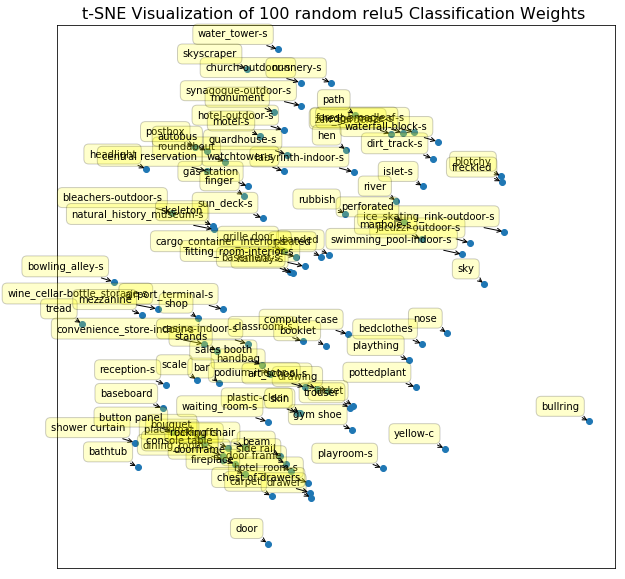

In [148]:
from sklearn.manifold import TSNE

#task = 'Segmentation'
task = 'Classification'
for blob in blobs:
    if task is 'Segmentation':   
        idx = np.array([i for i in range(len(pc)) if pc[i] < 4 and pc[i] >= 0])
        norm_weights = weights[blob][idx]
    elif task is 'Classification':
        idx = np.arange(1,L)
        norm_weights = disc_weights[blob][idx,-1,:]
    else:
        assert(False)

    norm_weights = np.array([np.true_divide(norm_weights[i], np.linalg.norm(norm_weights[i])) for i in range(len(norm_weights))])
    norm_weights = np.true_divide(norm_weights - np.mean(norm_weights, axis=0), np.std(norm_weights, axis=0))

    tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
    tsne_results = tsne.fit_transform(norm_weights)

    f, ax = plt.subplots(1,1, figsize=(10,10))

    num_random = 100
    if task is 'Segmentation':
        rand_idx = np.random.choice(np.arange(12,len(idx)), size=100, replace=False)
    else:
        rand_idx = np.random.choice(len(idx), size=100, replace=False)
    #rand_idx = np.arange(len(idx))
    
    #rand_idx = rand_idx[rand_idx > 12]
    #rand_idx = [np.where(label_names[idx] == k)[0][0] for k in voc_labels.keys()]

    ax.scatter(
        tsne_results[rand_idx,0], tsne_results[rand_idx, 1], marker='o',
        cmap=plt.get_cmap('Spectral'))

    for label, x, y in zip(label_names[idx[rand_idx]], tsne_results[rand_idx,0], tsne_results[rand_idx,1]):
        plt.annotate(
            label,
            xy=(x,y), xytext=(-10, 10),
            textcoords='offset points', ha='right', va='bottom',
            bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.2),
            arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

    ax.set_xticks([])
    ax.set_yticks([])
    #ax.set_title('t-SNE Visualization of VOC %s %s Weights' % (blob_names[blob], task))
    ax.set_title('t-SNE Visualization of %d random %s %s Weights ' % (num_random, blob_names[blob], task))
    plt.show()

In [166]:
blob = 'features.11'
task = 'Classification'

if task is 'Segmentation':   
    idx = np.array([i for i in range(len(pc)) if pc[i] < 4 and pc[i] >= 0])
    norm_weights = weights[blob][idx]
elif task is 'Classification':
    idx = np.arange(1,L)
    norm_weights = disc_weights[blob][idx,-1,:]
else:
    assert(False)

norm_weights = np.array([np.true_divide(norm_weights[i], np.linalg.norm(norm_weights[i])) for i in range(len(norm_weights))])
norm_weights = np.true_divide(norm_weights - np.mean(norm_weights, axis=0), np.std(norm_weights, axis=0))

n = 75
kmeans = KMeans(n_clusters=n).fit(norm_weights)
print 'K-Means with N = %d clusters' % n
for i in range(n):
    print '\item', ', '.join(label_names[idx[np.where(kmeans.labels_ == i)[0]]])

K-Means with N = 75 clusters
\item truck, traffic light, poster, trade name, shop window, minibike, manhole, crosswalk, umbrella, autobus, container, shutter, text, curb, central reservation, post, metal shutter, cloud, windows, crane, postbox, trunk, banner, booth, alley-s, telephone booth, sales booth, scaffolding, billboard, garage-indoor-s, roundabout-s, bus stop, ad, metal shutters, roundabout, terrace, revolving door, parterre, forklift, crosswalk-s, bus_shelter-s
\item woven, meshed, grid, zigzagged, window_seat-s, bow_window-indoor-s, archive-s, bow_window-outdoor-s, atrium-public-s, doorway-outdoor-s, shopfront-s, balcony-exterior-s, jail-indoor-s, wine_cellar-bottle_storage-s, anechoic_chamber-s, bedchamber-s, throne_room-s
\item side, front, radiator, face, rack, waiting_room-s, cradle, childs_room-s, nursery-s, slats, safety side
\item pillar, pedestal, counter, fluorescent, bulletin board, handbag, pane of glass, traveling bag, airport_terminal-s, partition, diffusor, vend